## Problem Definition

1. By conducting Sentiment analysis (positive, negative or neutral ) of texts, we can analyse and evaluate amazon foods reputation, strengths and weaknesses of food business and customer needs for food business. 

Questions: Which words/phrases have the most impact on review scores?


Techniques that can be used for sentiment analysis
- Text blob
- SentiWordNet
- Afinn

2. By using K-mean clustering, we can cluster a plenty of reviews into certain few types of categories or themes and find mutual main issues or problems in amazon food buisnesses. 

Questions: What is the impact of Amazon food business topics on review scores?


Techniques that can be used for k-mean clustering
- from sklearn.cluster import KMeans
- from sklearn.metrics.pairwise import cosine_similarity 

3. Data mining

Questions: 
What is the lexical field for good reviews?, 
What are the main issues that frequently emerge in food business?

Techniques that can be sued for data mining
- TF-IDF
- Word cloud (Visualization)
- N-grams Frequencies



In [ ]:
%matplotlib inline 


import pandas as pd
import numpy as np
import glob
import os

import seaborn as sns
import matplotlib.pyplot as plt

from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer, ENGLISH_STOP_WORDS 
from textblob import TextBlob
from nltk import word_tokenize
from nltk.tokenize import sent_tokenize
from nltk.stem import PorterStemmer, WordNetLemmatizer
import nltk
nltk.download('punkt')
import string


from langdetect import detect_langs
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

from textatistic import Textatistic

import spacy

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.svm import SVR
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.metrics import mean_squared_error, r2_score
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


True

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
# After executing the cell above, Drive files will be present in "/content/drive/My Drive". The below command lists the contents in the drive:
!ls "/content/drive/My Drive/Colab Notebooks"

'Copy of ANLP Session 1_NLP_Basics.ipynb의 사본'   Review.ipynb
'Covid death report.ipynb'			   Reviews.csv
 covid_worldwide.csv				   Untitled0.ipynb


In [ ]:
url = '/content/drive/My Drive/Colab Notebooks/Reviews.csv'
df = pd.read_csv(url)
df

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...
...,...,...,...,...,...,...,...,...,...,...
568449,568450,B001EO7N10,A28KG5XORO54AY,Lettie D. Carter,0,0,5,1299628800,Will not do without,Great for sesame chicken..this is a good if no...
568450,568451,B003S1WTCU,A3I8AFVPEE8KI5,R. Sawyer,0,0,2,1331251200,disappointed,I'm disappointed with the flavor. The chocolat...
568451,568452,B004I613EE,A121AA1GQV751Z,"pksd ""pk_007""",2,2,5,1329782400,Perfect for our maltipoo,"These stars are small, so you can give 10-15 o..."
568452,568453,B004I613EE,A3IBEVCTXKNOH,"Kathy A. Welch ""katwel""",1,1,5,1331596800,Favorite Training and reward treat,These are the BEST treats for training and rew...


In [ ]:
df.describe()

,Id,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time
count,568454.000000,568454.000000,568454.00000,568454.000000,5.684540e+05
mean,284227.500000,1.743817,2.22881,4.183199,1.296257e+09
std,164098.679298,7.636513,8.28974,1.310436,4.804331e+07
min,1.000000,0.000000,0.00000,1.000000,9.393408e+08
25%,142114.250000,0.000000,0.00000,4.000000,1.271290e+09
50%,284227.500000,0.000000,1.00000,5.000000,1.311120e+09
75%,426340.750000,2.000000,2.00000,5.000000,1.332720e+09
max,568454.000000,866.000000,923.00000,5.000000,1.351210e+09


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568454 entries, 0 to 568453
Data columns (total 10 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   Id                      568454 non-null  int64 
 1   ProductId               568454 non-null  object
 2   UserId                  568454 non-null  object
 3   ProfileName             568438 non-null  object
 4   HelpfulnessNumerator    568454 non-null  int64 
 5   HelpfulnessDenominator  568454 non-null  int64 
 6   Score                   568454 non-null  int64 
 7   Time                    568454 non-null  int64 
 8   Summary                 568427 non-null  object
 9   Text                    568454 non-null  object
dtypes: int64(5), object(5)
memory usage: 43.4+ MB


In [ ]:
df.sample(10)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
253688,253689,B000FPGYTQ,A2B83M7X5HMC2B,Idaho Fischer,0,0,5,1308787200,10 month old LOVES these!,I bought this package for our 10 month old to ...
322480,322481,B000LKXRPY,A2M1JX96WSNXXK,"Shannon Hawkins ""smythee""",1,1,5,1322956800,Vruit juice,My 3-year-old son loves this juice! It took a ...
405809,405810,B004QXUIO0,A3U8JKGCAQFBQI,Ciara,0,1,5,1343606400,Starbucks VIA Iced Coffee 6 pack,I love this product! Since it has 6 packets *...
487651,487652,B000GJQ5C2,A131T482HPX7KL,violet g,5,7,4,1184889600,Great,We picked up three of the small cakes in the B...
713,714,B000G6MBX2,A3I7NZC5LUVPPW,Carolyn Waters,0,0,5,1198886400,These chips are addictive!,"<a href=""http://www.amazon.com/gp/product/B000..."
233686,233687,B0044CZ6UO,ANYD5OP35KI3A,mommy of twins,0,0,4,1316995200,not for all kids,This particular flavor got mixed reviews from ...
78659,78660,B00472I5A4,A3D7FUBG14QWKX,Linda,0,4,1,1330732800,Garbage,Don't waste your money on any of the Kettle br...
550533,550534,B000MXHR0G,A251OTCDOJVQLJ,Rachel Baldes,0,0,5,1322697600,My baby loves prunes!,We try to buy her Nature's Best Organics but t...
519750,519751,B002ATEZJG,A1YVH4YXCA9EPY,T.J.,0,0,5,1349913600,Better than others I've tried,I've been using Maranantha almond butter in th...
565983,565984,B0032BOIH0,A3TOCYY695UKS1,PC,0,0,5,1318896000,Best Product for My Yorkie,I have been buying this product since I bought...


## Relationship between columns

<AxesSubplot: >

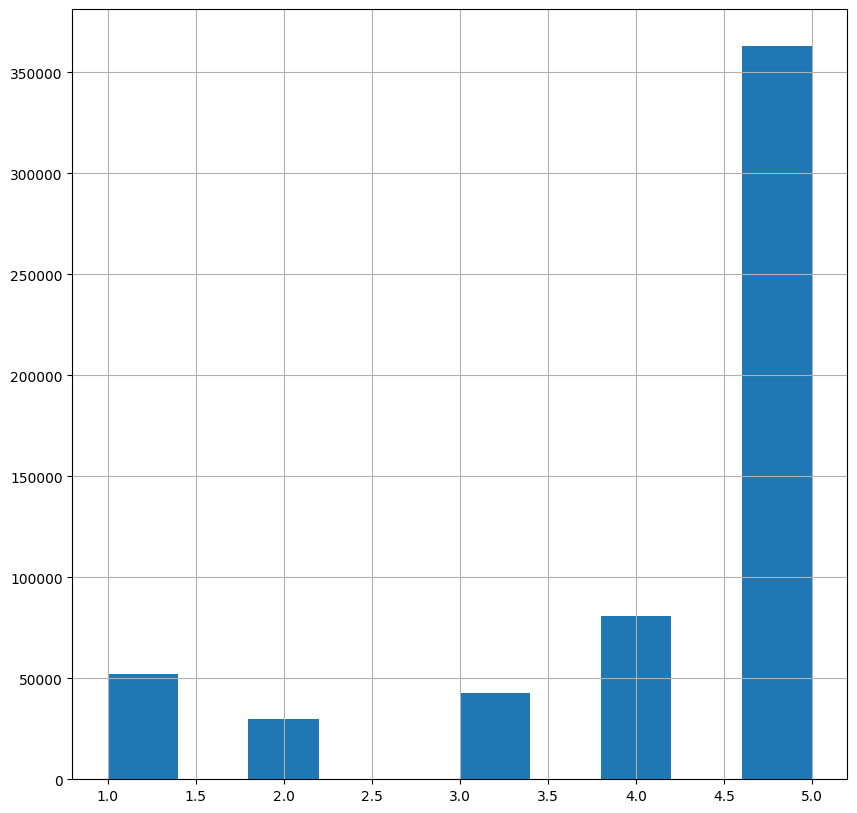

In [ ]:
df['Score'].hist()

C:\Users\dlatl\AppData\Local\Temp\ipykernel_19180\3935282096.py:2: FutureWarning: The default value of numeric_only in DataFrame.corr is deprecated. In a future version, it will default to False. Select only valid columns or specify the value of numeric_only to silence this warning.
  sns.heatmap(df.corr());


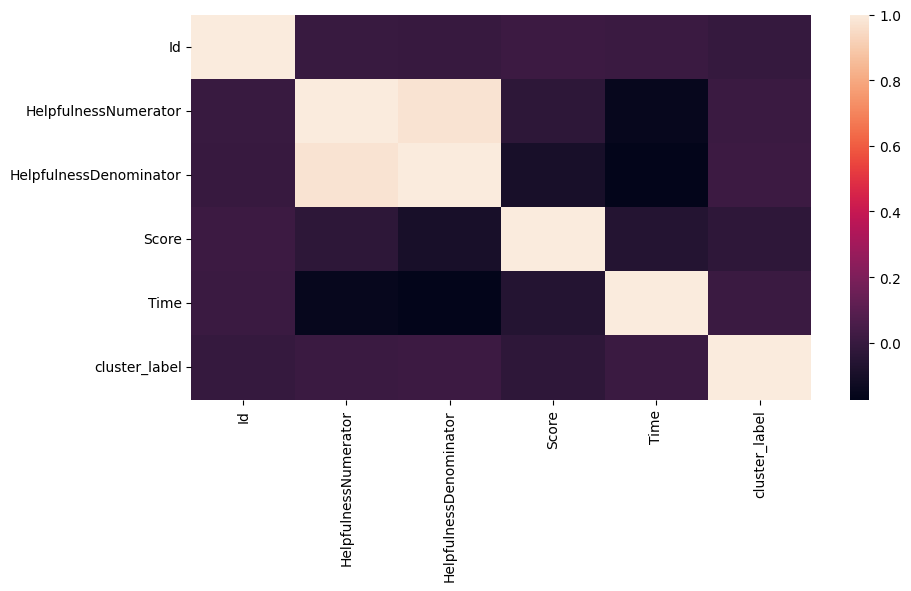

In [ ]:
plt.figure(figsize=(10, 5))
sns.heatmap(df.corr());

In [ ]:
missing_cols = []

for i in df.columns:
    if df[i].isnull().sum() > 0:
        missing_cols.append(i)
        
missing_cols

['ProfileName', 'Summary']

In [ ]:
import plotly.express as px
px.scatter(df, x = 'HelpfulnessNumerator', y = 'HelpfulnessDenominator', 
           color = 'HelpfulnessNumerator', trendline="rolling", trendline_options=dict(window=5),
           title= 'HelpfulnessNumerator')

In [ ]:

px.scatter(df, x = 'HelpfulnessNumerator', y = 'Score', 
           color = 'HelpfulnessNumerator', trendline="rolling", trendline_options=dict(window=5),
           title= 'HelpfulnessNumerator')

In [ ]:

px.scatter(df, x = 'HelpfulnessDenominator', y = 'Score', 
           color = 'HelpfulnessDenominator', trendline="rolling", trendline_options=dict(window=5),
           title= 'HelpfulnessDenominator')

In [ ]:

for column in df.columns:
    fig, axes = plt.subplots(1, 2, figsize = (15, 5))
    sns.histplot(x = df[column], ax = axes[0]).set(title = column)
    sns.boxplot(x  = df[column], ax = axes[1]).set(title = column)
    fig.show()

In [ ]:
df.Text[60]

'Watch your prices with this.  While the assortment was good, and I did get this on a gold box purchase, the price for this was<br />$3-4 less at Target.'

In [ ]:
import re

def clean(text) :
    text = re.sub(r'\S*@\S*\s?', '', text) # Remove email ids
    text = re.sub(r'\s+', ' ', text) # Remove newline (\n)
    text = re.sub(r"\'", "", text) # Remove quotes
    text = re.sub(r"(From:).*(Lines: )\d*?( )", "", text)
    return text


In [ ]:
df["Text"] = df["Text"].apply(clean)
df.Text[60]

'Watch your prices with this. While the assortment was good, and I did get this on a gold box purchase, the price for this was<br />$3-4 less at Target.'

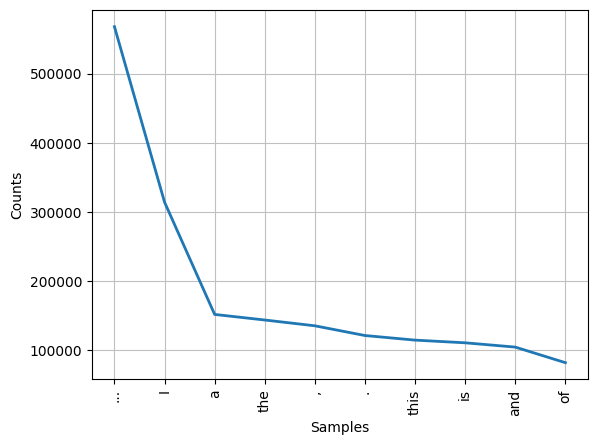

[('...', 568163), ('I', 314342), ('a', 151927), ('the', 143865), (',', 135491), ('.', 121416), ('this', 114764), ('is', 110880), ('and', 104673), ('of', 82148), ('to', 81399), ('This', 70318), ('for', 64601), ('my', 59304), ('have', 57121), ('these', 49776), ('are', 47894), ('was', 45037), ('it', 42670), ('in', 41849)]


In [ ]:
# Change 'sentence' column data type from object to string
words = df['Text'].to_string()
tokenized_words = word_tokenize(words)
all_words=nltk.FreqDist(tokenized_words)
all_words.plot(10);
plt.rcParams['figure.figsize'] = (10,10)
print(all_words.most_common(20))

['i', 'me', 'my', 'myself', 'we', 'our', 'ours', 'ourselves', 'you', "you're", "you've", "you'll", "you'd", 'your', 'yours', 'yourself', 'yourselves', 'he', 'him', 'his', 'himself', 'she', "she's", 'her', 'hers', 'herself', 'it', "it's", 'its', 'itself', 'they', 'them', 'their', 'theirs', 'themselves', 'what', 'which', 'who', 'whom', 'this', 'that', "that'll", 'these', 'those', 'am', 'is', 'are', 'was', 'were', 'be', 'been', 'being', 'have', 'has', 'had', 'having', 'do', 'does', 'did', 'doing', 'a', 'an', 'the', 'and', 'but', 'if', 'or', 'because', 'as', 'until', 'while', 'of', 'at', 'by', 'for', 'with', 'about', 'against', 'between', 'into', 'through', 'during', 'before', 'after', 'above', 'below', 'to', 'from', 'up', 'down', 'in', 'out', 'on', 'off', 'over', 'under', 'again', 'further', 'then', 'once', 'here', 'there', 'when', 'where', 'why', 'how', 'all', 'any', 'both', 'each', 'few', 'more', 'most', 'other', 'some', 'such', 'no', 'nor', 'not', 'only', 'own', 'same', 'so', 'than', '

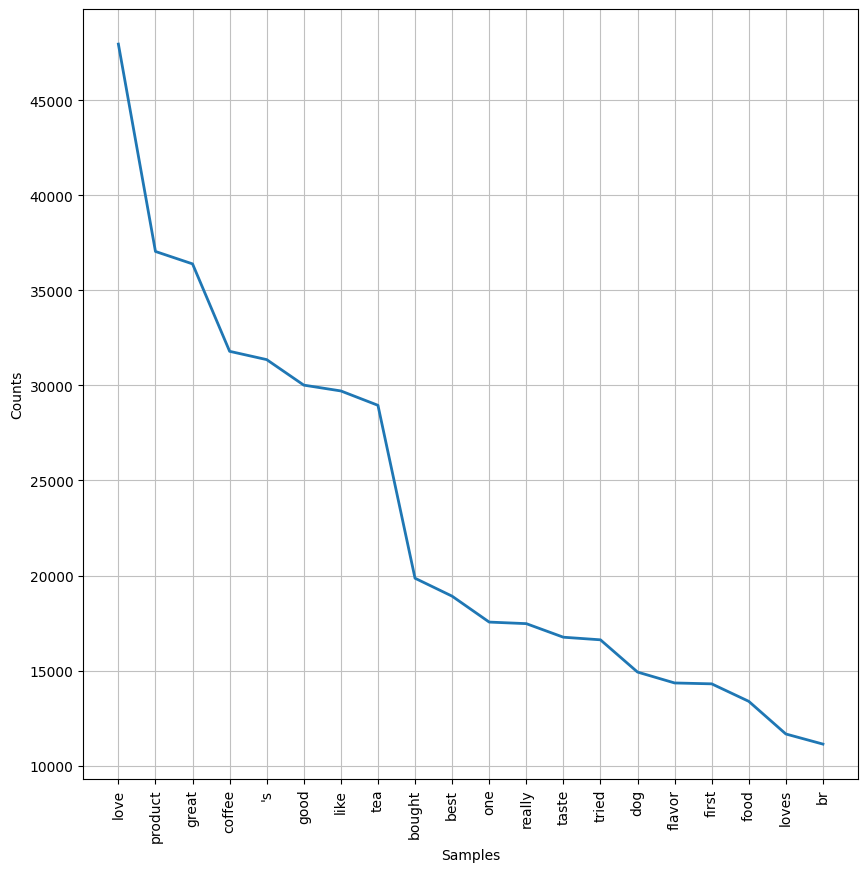

[('love', 47961), ('product', 37050), ('great', 36396), ('coffee', 31796), ("'s", 31359), ('good', 30017), ('like', 29711), ('tea', 28955), ('bought', 19856), ('best', 18912), ('one', 17549), ('really', 17467), ('taste', 16753), ('tried', 16616), ('dog', 14919), ('flavor', 14346), ('first', 14299), ('food', 13379), ('loves', 11661), ('br', 11129)]


In [ ]:
text_lower = words.lower()
# Only tokenized words that contain lower case letters, as imporatnt words are more likely to be specific nouns. 
tokenized_words=word_tokenize(text_lower)

import string
from nltk.corpus import stopwords
#stopwords "english" contains many subjective and objective words such as 'i', 'myself' and 'you'.
stop_words=stopwords.words("english")
print(stop_words)
# Adding more unnecessary words into stop_words. 
stop_words.extend(["get","need", "s", "a", "the", "I", "What", "Is", "How", "n't", "Will", "Can", "Does", "Are", "If", "The", "'ve", "'m", "j", "th", "go",])

filtered_tokens = []
for i in tokenized_words:
  if i not in stop_words:
    filtered_tokens.append(i)

# punctuations, which contain '?', '' and '!'
punctuations=list(string.punctuation)
#Add custom punctuations to the list
punctuations.append("...")
punctuations.append("?")

#Create a variable that include all filtered tokenized words. 
filtered_tokens_final=[]
for i in filtered_tokens:
    if i not in punctuations:
        filtered_tokens_final.append(i)

all_words=nltk.FreqDist(filtered_tokens_final)
all_words.plot(20);
print(all_words.most_common(20))

In [ ]:
all_words.most_common(10)

[('love', 48071),
 ('product', 37098),
 ('great', 36539),
 ('coffee', 31769),
 ('good', 30141),
 ('like', 29997),
 ('tea', 28915),
 ('bought', 19899),
 ('best', 18975),
 ('ive', 18065)]

In [ ]:
all_words.bar(10)

In [ ]:
pip install squarify

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
import squarify
import matplotlib.pyplot as plt
import seaborn as sb

# Tree map visualization of most frequent words
top_words = dict(Counter(all_words).most_common(50))
plt.rcParams['figure.figsize'] = (10,10)
plt.rcParams['font.size'] = 14

squarify.plot(label= top_words.keys()
              ,sizes= top_words.values(),
              color = sb.color_palette("magma", 
                                     len(top_words)),
              alpha= 0.8);

NameError: ignored

## K-means clustering

In [ ]:
import nltk
nltk.download('punkt')
nltk.download('wordnet')
import string
from nltk import word_tokenize
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics.pairwise import cosine_similarity 

words = df['Text'].to_string()

#tokenized_words=word_tokenize(text_lower)

# lemmatizing words based on contexts and usage of words in sentences
lemmar = WordNetLemmatizer()
def LemTokens(tokens):
    return [lemmar.lemmatize(token) for token in tokens]


# Removing punctuations, which contain '?', '' and '!'
punctuations= dict((ord(punctuation), None) for punctuation in string.punctuation)


#filtered_tokens_final=[]
#for i in filtered_tokens:
    #if i not in punctuations:
        #filtered_tokens_final.append(i)

def filtered_token_final(text):
  text_lower = text.lower().translate(punctuations) # converting text into lower case and removing punctuations
  tokenized_words=word_tokenize(text_lower) # tokenizing words
  return LemTokens(tokenized_words) # Lemmatizing tokenzied words

tfidf_vectorizer = TfidfVectorizer(stop_words='english' , ngram_range=(1,2), 
                             tokenizer = filtered_token_final, min_df=0.05, max_df=0.85)

# TfidfVectorizer
feature_vect = tfidf_vectorizer.fit_transform(df['Text'])

[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to /root/nltk_data...
/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:528: UserWarning:

The parameter 'token_pattern' will not be used since 'tokenizer' is not None'

/usr/local/lib/python3.10/dist-packages/sklearn/feature_extraction/text.py:409: UserWarning:

Your stop_words may be inconsistent with your preprocessing. Tokenizing the stop words generated tokens ['ha', 'le', 'u', 'wa'] not in stop_words.



In [ ]:
from sklearn.cluster import KMeans

# will split data into three clusters.
km_cluster = KMeans(n_clusters=3, max_iter=10000, random_state=0)
km_cluster.fit(feature_vect)

# cluster label and centers 
cluster_label = km_cluster.labels_
cluster_centers = km_cluster.cluster_centers_

# Add 'cluster_label' column
df['cluster_label'] = cluster_label
df.sample(5)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label
181259,181260,B007Y59HVM,A3894HVWP1YAG8,Jeanette Szwec,10,14,3,1322265600,Doesn't fit in all Keurig makers,"This is decent coffee at a good price, but the...",1
33244,33245,B001EQ54M8,A3M330JARMFYTI,Mag3.14,1,1,5,1335398400,SO GOOD!,this is my favorite roast coffee. I love the d...,1
515293,515294,B000GG0BM0,A2VPMYLLVFC2QQ,"Jayanta Chatterjee ""Bearcat""",1,1,5,1305244800,Bigelow' Darjeeling tea.,This tea is superb in terms of taste and aroma...,0
313212,313213,B002HI4PEK,A461VTLW9G9YB,Dance Dance Dance,0,0,5,1323216000,yummy,I first tried this last year at starbucks. Now...,2
57298,57299,B00817GPWQ,A13J57AACBVI5I,proshopper,17,17,5,1269648000,The name says it all.,I have been looking for Amazon to start carryi...,1


In [ ]:
df[df['cluster_label']==0].sort_values(by='Text')

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label
126462,126463,B004569PAG,A3LHF3RUAS4WLC,Leonid,1,1,5,1329868800,unique and robust,"""...smoothly blends the high notes of a high g...",0
333019,333020,B0000CFXYA,A1S6LV2XO6EN3B,"KuddlKat ""Techie""",1,2,2,1277769600,"""Tins"" means Tins, not envelopes","""6 Tins"" arrived as 1 tin wrapped in paper and...",0
341865,341866,B0017WO2JK,A230CAH5O7B9FQ,Melissa,0,0,2,1340236800,What flavor?,"""A delicate tea with enticing hints of blueber...",0
375986,375987,B0000DBN1I,A281NPSIMI1C2R,"Rebecca of Amazon ""The Rebecca Review""",0,0,5,1074988800,Peaceful Thoughts...,"""A single cup of Tazo Calm has been known to h...",0
540656,540657,B001D0GV90,A33RONBC0EU0A2,Pete Zar,2,3,5,1289433600,For Real Coffee Lovers Only,"""DO NOT BUY THIS ITEM""... UNLESS...... you can...",0
...,...,...,...,...,...,...,...,...,...,...,...
165926,165927,B0009F3SA0,A3ACO0LANLBE1Z,"mac cam ""macmom""",1,1,5,1264809600,love yogi tea,yogi teas are the best tasting tea i have ever...,0
208841,208842,B000E8Y5D6,A6F6Z1T9OZK8M,david olenick,0,12,1,1163808000,o expensive,you can buy lipton for less than 4.00 / 6 oz a...,0
548580,548581,B000LKXRIQ,A1264Q1DKK4BZ7,twiggy2theinfinitepower,1,1,5,1326931200,If you like jasmin green tea...,you will LOVE this tea. It's been a long time ...,0
119998,119999,B000CMF18W,AZ31S5ACWRY15,Tosha,1,1,4,1303516800,If you like black licorice ......,you'll like the way this tea tastes. I don't ...,0


The first cluster is mainly associated with reviews about tea businesses. 

In [ ]:
df[df['cluster_label']==1].sort_values(by='Text')

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label
354033,354034,B001A4B8EM,APQ50DQHSNYFR,Ryan Kirk,79,79,1,1283644800,Amazon should be ashamed to even carry this.,"""2% Kopi Luwak"" That's the key part in the de...",1
157070,157071,B002TMV3GC,A2DSXA1E02C86D,Joseph Haschka,0,0,3,1310256000,Where's the romance?,"""A European classic. Sweet caramel and rich va...",1
484179,484180,B0002AHT8E,A3UDAKM6LSHINQ,katyc,0,0,5,1338854400,Greek Coffee,"""Bravo"" Greek Coffee has the perfect color, ar...",1
124338,124339,B005ZBZM52,A2QTB6RFY12WGQ,Tuseline Goldstein,2,2,5,1323648000,Organic never tasted better!,"""By far the best cup of coffee ever!!!"". I rec...",1
440232,440233,B005ZBZLSU,A2QTB6RFY12WGQ,Tuseline Goldstein,1,2,5,1323648000,Looooove It!,"""By far the best cup of coffee ever!!!"". I rec...",1
...,...,...,...,...,...,...,...,...,...,...,...
147551,147552,B001D0IZBM,A2JEQBO69YNGGP,saraht,0,0,5,1350950400,best buy around,you can't beat the price for this coffee. You ...,1
109208,109209,B004AW5THI,A38H6PHZ1A0V26,utahsand,1,1,5,1343347200,awesome supplier,you realy cant beat the deal on coffee they of...,1
453763,453764,B00634YDEQ,A3Q9OI1LGJUW2G,"Jean Porter ""Jean Porter""",0,0,5,1343779200,great,your services were quick and as always the cof...,1
99757,99758,B001ELLAH6,A20CTKKZEQGD3E,"Akua Grant ""Akua Rising""",1,2,1,1262131200,Caffeen Addicts Need Not Apply,zzzzzzz. I had high hopes for this coffee and ...,1


The second cluster may be associated with coffee businesses. 

In [ ]:
df[df['cluster_label']==2].sort_values(by='Text')

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label
472747,472748,B000UXH9X8,A1B1Z0MDQ1YACN,Ronald E. Corbin,0,0,1,1345680000,sugar,! think I just ruined my dish. open this and p...,2
366022,366023,B0053TENTW,A3JG5OT0Z5Q1KE,Royal,2,2,1,1325894400,!!! FALSE ADVERTISEMENT !!!,!!! PRODUCT HAS NOTHING TO DO WITH MARVEL!!! F...,2
240425,240426,B001VJ0B0I,A1I6U5AQAT3ZG9,"E. B. MULLIGAN ""Bronwyn""",1,3,3,1342828800,Garlic oil? I thought Garlic was bad for dogs ...,!!!<br />Animal digest? She does that on her o...,2
502792,502793,B000V9ANUW,ALSAOZ1V546VT,"A Research It Maven ""Just the facts please""",1,1,5,1256688000,TWO big candy bars in EACH Package!,"!!HEY, these are BIG! There are actually two c...",2
386401,386402,B002UQBL9Q,A35PQDX1R6IG9E,Lost In The Cosmos,4,5,3,1330905600,There's a reason the description doesn't list ...,""" WITH "" ... Olive Oil. What does this mean...",2
...,...,...,...,...,...,...,...,...,...,...,...
563869,563870,B007JFMH8M,AES9VNGFZLOE1,Alexis McHenry,1,2,5,1342483200,Quaker Soft Baked Oatmeal Cookies,"~ Quick Take: Tasty, chewy, soft-baked cookies...",2
268111,268112,B001E6GFR6,A2FOR1IJSX76LQ,Sly,0,3,5,1282003200,"Yummy. yummy, yummy!!!",~<br /><br />These are soooooooooooooooooooooo...,2
61192,61193,B000FA38ZY,A26UNIPEVYE9DE,Becker,0,0,4,1320192000,PURE CHOCOLATE MALLOMARS COOKIES,~<br />This is a `3 for the price of 1' review...,2
527926,527927,B000VKADRY,A2CEDG8O4AYV8K,Diane A. Shultz,0,0,5,1211846400,Earth's Best Soy Baby Formula,"~Earth's Best Infant Formula Soy Iron, 13.2-Ou...",2


Lastly, third cluster is associated with reviews for foods. 

## Topic Modelling

In [ ]:
filtered_tokens_final2 = [filtered_tokens_final]

In [ ]:
# Topic modelling
import gensim
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem.wordnet import WordNetLemmatizer
dictionary = gensim.corpora.Dictionary(filtered_tokens_final2)
corpus = [dictionary.doc2bow(doc) for doc in filtered_tokens_final2]

In [ ]:
# Build LDA model
num_topics = 5
lda_model = gensim.models.LdaModel(corpus, num_topics=num_topics, id2word=dictionary, passes=10)

# Print topics
for idx, topic in lda_model.print_topics(-1):
    print(f'Topic: {idx} \nWords: {topic}\n')

Topic: 0 
Words: 0.016*"love" + 0.012*"product" + 0.012*"great" + 0.011*"coffee" + 0.010*"good" + 0.010*"like" + 0.010*"tea" + 0.007*"bought" + 0.006*"best" + 0.006*"ive"

Topic: 1 
Words: 0.001*"love" + 0.001*"product" + 0.001*"great" + 0.001*"coffee" + 0.001*"good" + 0.001*"tea" + 0.001*"like" + 0.001*"bought" + 0.000*"dog" + 0.000*"really"

Topic: 2 
Words: 0.001*"love" + 0.001*"tea" + 0.001*"product" + 0.001*"coffee" + 0.000*"best" + 0.000*"good" + 0.000*"great" + 0.000*"like" + 0.000*"ive" + 0.000*"tried"

Topic: 3 
Words: 0.001*"love" + 0.000*"product" + 0.000*"coffee" + 0.000*"great" + 0.000*"good" + 0.000*"like" + 0.000*"tea" + 0.000*"tried" + 0.000*"ive" + 0.000*"best"

Topic: 4 
Words: 0.000*"great" + 0.000*"product" + 0.000*"coffee" + 0.000*"love" + 0.000*"good" + 0.000*"like" + 0.000*"tea" + 0.000*"best" + 0.000*"taste" + 0.000*"bought"



## Feature Engineering

In [ ]:
# Add 'Helpfulness' column
df['Helpfulness'] = df['HelpfulnessNumerator']/df['HelpfulnessDenominator']
df.sample(5)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness
495896,495897,B003YBJ9F4,A3POAWC2JPQQQP,me,0,0,4,1347926400,no caffeine.... what's the point?,"If you like the taste of coffee, but are tryin...",1,NaN
358753,358754,B003CIBPN8,ABX4JQZC6OTTP,"Angela D. Holcomb ""Ang""",0,0,5,1320883200,Zico- great tasting,Tastes like a YooHoo- but so much healtier. I'...,2,NaN
108771,108772,B003DIOTX0,A12SAU7NR89O98,A. Olson,1,2,2,1310774400,Mac & Cheese Leftovers That No One Wants,Our gluten-free family of five has tried this ...,2,0.5
283205,283206,B000EDK774,ASRUYRC3R5J6Q,Betsy Heimbuch,14,14,1,1288656000,BEWARE OF BOB'S RED MILL YEAST,I purchased this Yeast because the description...,2,1.0
79293,79294,B003TNANSO,AUS545VE0P2J1,Paul,0,0,5,1350000000,Try frozen,I just finished my second box of the dark choc...,2,NaN


In [ ]:
df['Helpfulness'].isnull().sum()

270052

In [ ]:
df.dropna(how='any', subset=['Helpfulness'], inplace=True)

In [ ]:
df.sample(10)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness
309415,309416,B000LKXA2O,A2APXBRW3CBXCT,"Dennis Amaya ""Big D""",1,1,5,1202601600,Healthy but Delicious,It's not too sweet so it tastes great. I don...,2,1.000000
276248,276249,B000WN468M,ALTS466R0F4QW,"Special K ""Steve K.""",2,3,1,1263254400,Don't even bother,They listed this product as Small Bite Size. ...,2,0.666667
226290,226291,B002T0NWKE,A1QIHNZHUHQV08,"Susan Gardner Bowers ""Susu""",11,16,1,1306800000,Nasty,The non-diet flavors all have Splenda. In add...,2,0.687500
34034,34035,B00412W76S,AZ4QFFUT8QVTA,Nelly Gonzalez,1,1,5,1239321600,Relaxing,This tea works for me. It calms down my ancie...,0,1.000000
91445,91446,B004M1236M,A3DWGIDZUA8PE7,"Laura Louise Harden ""Taterbug""",1,1,2,1314316800,"Just ok, too much sugar. Not organic",I wrote a similar review for the other Peace c...,2,1.000000
412914,412915,B000E4C2LW,A2XOSNRYS9QUOS,C. Choi,4,4,5,1182816000,Wholesome and tasty food!,Our whole family loves this wholesome cereal. ...,2,1.000000
400136,400137,B002IEVJRY,A2DVBBARHJIW9J,KCinDC76,1,2,5,1321747200,My Guilty Pleasure...,"Yes, its expensive. But, I've given up my dai...",1,0.500000
171010,171011,B001BM395E,A2D3NI2KMATVU6,Mamma B,4,5,1,1334880000,Never Online again,I ordered this because I really like this bran...,2,0.800000
57882,57883,B000EVOSE4,A2OGU5RE2DSX2J,"Aeneas ""CenVA""",2,2,5,1167523200,Excellent Candy and Free Shipping,This is excellent candy. They can melt in your...,2,1.000000
478298,478299,B0007OVWSS,A2MRLQI7SAYXVT,Jessica J. Turnbow,2,6,1,1194480000,Picture Perfect Gumball Machine,I was very disappointed in the quality of the ...,2,0.333333


<Axes: xlabel='Helpfulness', ylabel='Count'>

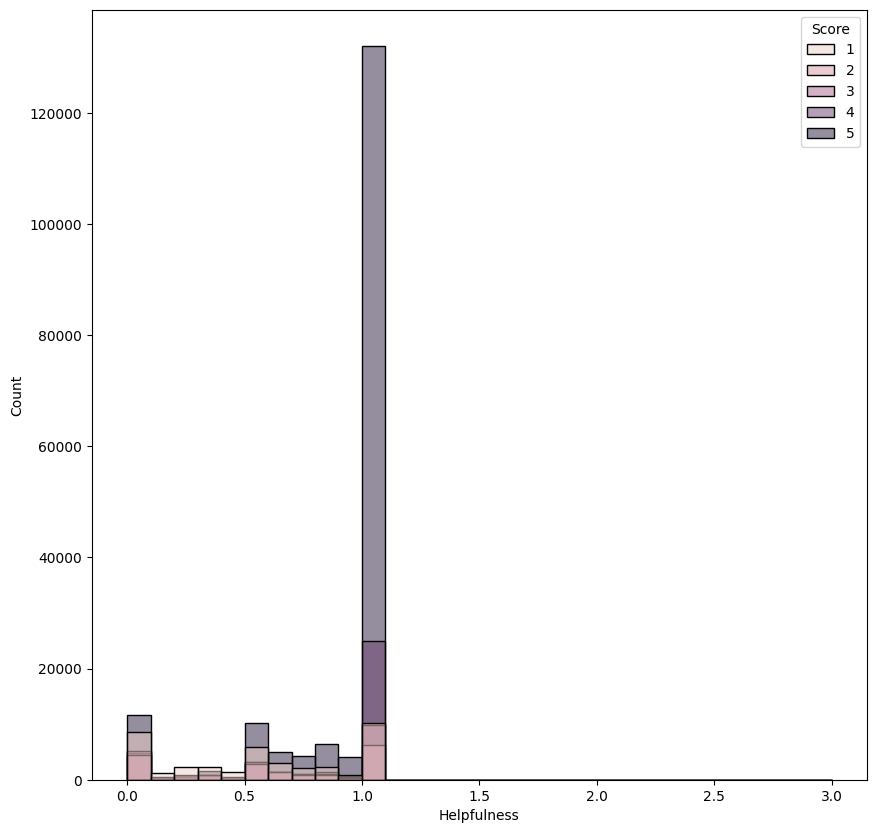

In [ ]:
sns.histplot(data = df, x = 'Helpfulness', hue = 'Score', binwidth = 0.1)

In [ ]:
# Creating Word Count numeric column
def word_count(Text):
    wc = len(Text.split())
    return wc

In [ ]:
df['word_count'] = df['Text'].apply(word_count)
df['word_count'].describe()
df['word_count'].head(10)

0      48
2      94
3      41
8      26
10    146
11     64
12     79
13     15
14     22
15     24
Name: word_count, dtype: int64

In [ ]:
df.sample(5)

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness,word_count
136479,136480,B006Q820X0,#oc-R2SVV5KG3GN1O1,tedT,4,11,1,1334880000,issue with actual k-cup,thought I would try something new. unfortunat...,2,0.363636,96
138775,138776,B000E63LME,A25GA0EK3RGVPK,Hales,1,1,5,1296604800,Best fruit tea,I love this brand- the fruit tea isn't way ove...,0,1.000000,43
159829,159830,B005VOONLW,A1F9Z42CFF9IAY,Mediahound,0,2,4,1336435200,Delicious coffee that is organic and fair-trade,This coffee is very smooth and has a great fla...,1,0.000000,85
335898,335899,B0009XQWDM,A1PYBVIV3V5UO5,"Leigh Dvarishkis ""Bed and Biscuit""",6,8,5,1174262400,Feeding it in my boarding kennel....excellent ...,"Although I do not buy Canidae through Amazon, ...",2,0.750000,178
503901,503902,B002GOYT1O,A2THGX4LOB6VFY,J. Weaver,1,1,4,1262736000,"Pretty Good, better then the rest.","I'm a big fan of chicken tikka masala, and bei...",2,1.000000,161


In [ ]:
# Filter to only data with Helpfulness value not NAN
df_Sample = df[df['Helpfulness'].notnull()][0:10000].reset_index()
df_Sample

,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness,word_count
0,0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,2,1.0,48
1,2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,2,1.0,94
2,3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,2,1.0,41
3,8,9,B000E7L2R4,A1MZYO9TZK0BBI,R. James,1,1,5,1322006400,Yay Barley,Right now I'm mostly just sprouting this so my...,2,1.0,26
4,10,11,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,I don't know if it's the cactus or the tequila...,2,1.0,146
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,19509,19510,B001EO5QO6,A3VL263FW0O1JL,Rivka,1,1,5,1198368000,Fresh and delicious!,Our health care provider recommended eating 1 ...,2,1.0,65
9996,19510,19511,B001EO5QO6,A23MGS2U5PPBY1,"Ethann Makinenni ""Ethann""",0,1,4,1173571200,They are great,"I eat these nuts daily, right after I eat some...",2,0.0,24
9997,19512,19513,B000E3VANE,A1F7SX3GNVBNE3,"Joshua G. Feldman ""Technophile""",6,6,5,1181001600,This is the best flavor of Zatarain's - univer...,I love all the flavors of Zatarain's. I love ...,2,1.0,250
9998,19513,19514,B000E3VANE,A5N60O5P83HSX,A. Newhouse,1,1,5,1311897600,"Great flavor, convenient to buy by the case",These are the same box mixes that I've been bu...,2,1.0,117


In [ ]:
# Tokenize each item in the Text column
word_tokens = [word_tokenize(review) for review in df_Sample.Text]
sent_tokens = [sent_tokenize(review) for review in df_Sample.Text]
blob = [TextBlob(review) for review in df_Sample.Text]

# Create an empty list to store the length of the Text
len_tokens = []
len_sent = []
Count_Punct = []
polarity = []
subjectivity = []
Readablitys = []

# Iterate over the word_tokens list and determine the length of each item
for i in range(len(word_tokens)):
    len_tokens.append(len(word_tokens[i]))
    len_sent.append(len(sent_tokens[i]))
    polarity.append(blob[i].sentiment[0])
    subjectivity.append(blob[i].sentiment[1])
    
    punctuation_count = 0
    for word in word_tokens[i]:
        if word in string.punctuation:
            punctuation_count += 1
    Count_Punct.append(punctuation_count)
    
    if len(word_tokens[i]) > 10 and len(sent_tokens[i]) >= 2 :
        Readablity = Textatistic(df_Sample['Text'][i]).scores['flesch_score']
    else:
        Readablity = 100
    Readablitys.append(Readablity)

# Create a new feature for the lengh of each review
df_Sample['n_words'] = len_tokens 
df_Sample['n_sents'] = len_sent 
df_Sample['polarity'] = polarity 
df_Sample['subjectivity'] = subjectivity 
df_Sample['n_punct'] = Count_Punct 
df_Sample['Readablity'] = Readablitys 

In [ ]:
df_Sample.head(5)

,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text,cluster_label,Helpfulness,word_count,n_words,n_sents,polarity,subjectivity,n_punct,Readablity
0,0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...,2,1.0,48,51,3,0.450000,0.433333,3,83.082500
1,2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...,2,1.0,94,109,8,0.133571,0.448571,15,93.468140
2,3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...,2,1.0,41,46,3,0.166667,0.533333,5,77.412114
3,8,9,B000E7L2R4,A1MZYO9TZK0BBI,R. James,1,1,5,1322006400,Yay Barley,Right now I'm mostly just sprouting this so my...,2,1.0,26,29,3,0.428571,0.545238,2,99.278462
4,10,11,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,I don't know if it's the cactus or the tequila...,2,1.0,146,184,4,0.208594,0.682478,29,87.806431


In [ ]:
# Load the en_core_web_m model
nlp = spacy.load('en_core_web_sm')
stopwords = spacy.lang.en.stop_words.STOP_WORDS

# Function to preprocess text
def preprocess(text):
        # Create Doc object
    doc = nlp(text, disable=['ner', 'parser'])
    # Generate lemmas
    lemmas = [token.lemma_ for token in doc]
    # Remove stopwords and non-alphabetic characters
    a_lemmas = [lemma for lemma in lemmas 
            if lemma.isalpha() and lemma not in stopwords]
    
    return ' '.join(a_lemmas)

# Apply preprocess to ted['transcript']
df_Sample['Text_Cleaned'] = df_Sample['Text'].apply(preprocess)

In [ ]:
def proper_nouns(text, model=nlp):
    # Create doc object
    doc = model(text)
    # Generate list of POS tags
    pos = [token.pos_ for token in doc]
    
    # Return number of proper nouns
    return pos.count('PROPN')

def nouns(text, model=nlp):
    # Create doc object
    doc = model(text)
    # Generate list of POS tags
    pos = [token.pos_ for token in doc]
    
    # Return number of other nouns
    return pos.count('NOUN')

# Apply Count of PRORN AND NOUN columns
df_Sample['n_PROPN'] = df_Sample['Text'].apply(proper_nouns)
df_Sample['n_NOUN'] = df_Sample['Text'].apply(nouns)

In [ ]:
pip install bertopic

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 120.7/120.7 kB 4.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 88.2/88.2 kB 8.0 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 5.2/5.2 MB 31.9 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 86.0/86.0 kB 10.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.0/7.0 MB 30.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 54.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 224.5/224.5 kB 22.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 53.6 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
    

In [ ]:
reviews= df_Sample['Text_Cleaned']
reviews.sample(5)

1264    I usually Pineapple coconut drink drink taste ...
8693    I taste cheese I taste unidentifiable chemical...
6594    I find Altoids lack buy new licorice flavor ni...
7545    good raw goat milk cheese market mild cheddar ...
960     EDIT I notice bag pound review star instead pr...
Name: Text_Cleaned, dtype: object

In [ ]:
from bertopic import BERTopic
from sklearn.feature_extraction.text import CountVectorizer


vectorizer_model = CountVectorizer(ngram_range=(1, 2), stop_words='english')

model = BERTopic(
    vectorizer_model=vectorizer_model,
    language='english', calculate_probabilities=True,
    verbose=True
)
topics, probs = model.fit_transform(reviews) #create topics

Batches:   0%|          | 0/313 [00:00<?, ?it/s]

2023-05-07 08:26:31,966 - BERTopic - Transformed documents to Embeddings
2023-05-07 08:27:28,074 - BERTopic - Reduced dimensionality
2023-05-07 08:27:39,231 - BERTopic - Clustered reduced embeddings


In [ ]:
df_Sample['topics'] = model.topics_

In [ ]:
df_Sample.head(5)

,index,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,...,n_words,n_sents,polarity,subjectivity,n_punct,Readablity,Text_Cleaned,n_PROPN,n_NOUN,topics
0,0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,...,51,3,0.450000,0.433333,3,83.082500,I buy Vitality dog food product find good qual...,2,8,2
1,2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",...,109,8,0.133571,0.448571,15,93.468140,confection century light pillowy citrus gelati...,12,13,76
2,3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,...,46,3,0.166667,0.533333,5,77.412114,look secret ingredient Robitussin I believe I ...,4,5,-1
3,8,9,B000E7L2R4,A1MZYO9TZK0BBI,R. James,1,1,5,1322006400,Yay Barley,...,29,3,0.428571,0.545238,2,99.278462,right I sprout cat eat grass love I rotate Whe...,2,2,75
4,10,11,B0001PB9FE,A3HDKO7OW0QNK4,Canadian Fan,1,1,5,1107820800,The Best Hot Sauce in the World,...,184,4,0.208594,0.682478,29,87.806431,I know cactus tequila unique combination ingre...,5,23,12


In [ ]:
# Create sparse matrix from the vectorizer
vect = TfidfVectorizer(stop_words='english', ngram_range=(1, 2), max_features=200, token_pattern=r'\b[^\d\W][^\d\W]+\b').fit(df_Sample.Text_Cleaned)

X = vect.transform(df_Sample.Text_Cleaned)
# Create a DataFrame
reviews_transformed = pd.DataFrame(X.toarray())
print('Top 5 rows of the DataFrame: \n', reviews_transformed.head())

Top 5 rows of the DataFrame: 
    0    1    2    3        4    5    6    7    8    9    ...  190       191  \
0  0.0  0.0  0.0  0.0  0.00000  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.000000   
1  0.0  0.0  0.0  0.0  0.00000  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.000000   
2  0.0  0.0  0.0  0.0  0.00000  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.000000   
3  0.0  0.0  0.0  0.0  0.00000  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.000000   
4  0.0  0.0  0.0  0.0  0.14067  0.0  0.0  0.0  0.0  0.0  ...  0.0  0.216777   

   192  193  194  195  196  197  198  199  
0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
1  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
2  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
3  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  
4  0.0  0.0  0.0  0.0  0.0  0.0  0.0  0.0  

[5 rows x 200 columns]


In [ ]:
Other_Features = df_Sample[['n_words', 'n_sents', 'polarity', 'subjectivity','n_punct', 'Readablity', 'n_PROPN', 'n_NOUN', 'cluster_label', 'topics']]
# Combine the vectorizer with other feature columns:
Features = pd.concat([reviews_transformed, Other_Features], axis=1)
Features

,0,1,2,3,4,5,6,7,8,9,...,n_words,n_sents,polarity,subjectivity,n_punct,Readablity,n_PROPN,n_NOUN,cluster_label,topics
0,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,51,3,0.450000,0.433333,3,83.082500,2,8,2,2
1,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,109,8,0.133571,0.448571,15,93.468140,12,13,2,76
2,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,46,3,0.166667,0.533333,5,77.412114,4,5,2,-1
3,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,29,3,0.428571,0.545238,2,99.278462,2,2,2,75
4,0.000000,0.000000,0.000000,0.0,0.14067,0.0,0.000000,0.0,0.000000,0.000000,...,184,4,0.208594,0.682478,29,87.806431,5,23,2,12
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.239314,0.0,0.000000,0.000000,...,69,4,0.071581,0.411467,4,86.218173,0,14,2,36
9996,0.000000,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.000000,...,28,2,0.571429,0.633929,4,88.905000,0,1,2,36
9997,0.118794,0.000000,0.000000,0.0,0.00000,0.0,0.000000,0.0,0.134205,0.114171,...,287,19,0.158333,0.390946,36,89.644084,9,47,2,32
9998,0.000000,0.155029,0.146508,0.0,0.00000,0.0,0.000000,0.0,0.219329,0.000000,...,146,5,0.143348,0.412798,23,82.019130,6,20,2,-1


In [ ]:
y = y = df_Sample.Helpfulness
x_features = df_Sample[['n_words', 'n_sents', 'polarity', 'subjectivity','n_punct', 'Readablity', 'n_PROPN', 'n_NOUN', 'cluster_label', 'topics']]
X = x_features

In [ ]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.preprocessing import StandardScaler

In [ ]:
df.groupby(['Helpfulness'])[['Text']].count()

,Text
Helpfulness,
0.000000,33774
0.010989,1
0.021277,1
0.022222,4
0.023256,1
...,...
0.996198,1
0.996894,1
1.000000,183309


In [ ]:
X_train, X_test, y_train, y_test =  train_test_split(X, y, test_size=0.2, random_state=426)

In [ ]:
multi_scaler = StandardScaler()
multi_scaler_training = multi_scaler.fit_transform(X_train)
multi_scaler_testing = multi_scaler.fit_transform(X_test)


In [ ]:
mm_linear_train = LinearRegression(fit_intercept=True)
mm_linear_test = LinearRegression(fit_intercept=True)

In [ ]:
mm_linear_train.fit(multi_scaler_training, y_train)

LinearRegression()

In [ ]:
mm_linear_preds = mm_linear_train.predict(multi_scaler_testing)

In [ ]:
r2_score(y_test, mm_linear_preds)

0.03849295179962864

In [ ]:
print(mm_linear_train.score(multi_scaler_testing, mm_linear_preds))

1.0


In [ ]:
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

multivariate_mae  = mean_absolute_error(y_test, mm_linear_preds)
multivariate_mse = mean_squared_error(y_test, mm_linear_preds, multioutput = 'uniform_average')
multivariate_rmse = mean_squared_error(y_test, mm_linear_preds, squared=False)

print("MAE:", multivariate_mae)
print("MSE:", multivariate_mse)
print("RMSE:", multivariate_rmse)


MAE: 0.2864675318845052
MSE: 0.11971367852366367
RMSE: 0.3459966452491464


In [89]:
df_pred_multi = pd.DataFrame({'Actual Value (Best Features)'    : y_test,
                              'Predicted Value (Best Features)' : mm_linear_preds,
                              'Difference (Best Features)'      : abs(y_test - mm_linear_preds)})


df_pred_multi

,Actual Value (Best Features),Predicted Value (Best Features),Difference (Best Features)
6052,1.000000,0.735582,0.264418
1396,0.000000,0.634916,0.634916
8752,1.000000,0.690931,0.309069
355,0.833333,0.795764,0.037569
7665,1.000000,0.744319,0.255681
...,...,...,...
9426,1.000000,0.940137,0.059863
5918,1.000000,0.824106,0.175894
4612,1.000000,0.747524,0.252476
8415,1.000000,0.787709,0.212291


In [90]:
import altair as alt

perfect_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': y_test})).mark_line(color='red').encode(
    x='Helpfulness',
    y='preds'
)

pred_chart_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': mm_linear_preds})).mark_line().encode(
    x='Helpfulness',
    y='preds'
  )

pred_chart_test + perfect_test

alt.LayerChart(...)

In [92]:
import statsmodels.api as sm
sm_st_xtrain = sm.add_constant(multi_scaler_training)

In [93]:
lr_feat = sm.OLS(y_train, sm_st_xtrain).fit()

In [95]:
lr_summary = sm.OLS(y_train, sm_st_xtrain).fit()

In [96]:
lr_summary.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:            Helpfulness   R-squared:                       0.037
Model:                            OLS   Adj. R-squared:                  0.035
Method:                 Least Squares   F-statistic:                     30.40
Date:                Sun, 07 May 2023   Prob (F-statistic):           3.18e-58
Time:                        08:54:25   Log-Likelihood:                -2887.4
No. Observations:                8000   AIC:                             5797.
Df Residuals:                    7989   BIC:                             5874.
Df Model:                          10                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7638      0.004    196.669      0.000       0.756       0.771
x1            -0.0135      0.021     -0.632      0.528      -0.056       0.028
x2             0.0225      0.008      2.965      0.003       0.008       0.037
x3             0.0638      0.004     15.332      0.000       0.056       0.072
x4            -0.0054      0.004     -1.327      0.185      -0.013       0.003
x5            -0.0390      0.012     -3.299      0.001      -0.062      -0.016
x6            -0.0143      0.004     -3.348      0.001      -0.023      -0.006
x7             0.0044      0.006      0.717      0.473      -0.008       0.016
x8             0.0430      0.016      2.747      0.006       0.012       0.074
x9            -0.0038      0.004     -0.959      0.338      -0.011       0.004
x10            0.0107      0.004      2.723      0.006       0.003       0.018
==============================================================================
Omnibus:                     1272.975   Durbin-Watson:                   2.021
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1993.269
Skew:                          -1.220   Prob(JB):                         0.00
Kurtosis:                       3.157   Cond. No.                         13.6
==============================================================================

Notes:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

KNN Regressor

In [98]:
knn_train = KNeighborsRegressor(n_neighbors=40, metric='manhattan')
knn_test = KNeighborsRegressor(n_neighbors=40, metric='manhattan')

In [99]:
knn_train.fit(multi_scaler_training, y_train)

KNeighborsRegressor(metric='manhattan', n_neighbors=40)

In [100]:
knn_preds = knn_train.predict(multi_scaler_testing)

In [101]:
r2_score(y_test, knn_preds)

0.033412862819506395

In [102]:
print(knn_train.score(multi_scaler_testing, knn_preds))

1.0


In [103]:
knn_mae  = mean_absolute_error(y_test, knn_preds)
knn_mse = mean_squared_error(y_test, knn_preds, multioutput = 'uniform_average')
knn_rmse = mean_squared_error(y_test, knn_preds, squared=False)

print("MAE:", knn_mae)
print("MSE:", knn_mse)
print("RMSE:", knn_rmse)

MAE: 0.28040961040624973
MSE: 0.12034618157205654
RMSE: 0.34690947172433406


In [104]:
df_pred_knn = pd.DataFrame({'Actual Value (Best Features)'    : y_test,
                              'Predicted Value (Best Features)' : knn_preds,
                              'Difference (Best Features)'      : abs(y_test - knn_preds)})


df_pred_knn

,Actual Value (Best Features),Predicted Value (Best Features),Difference (Best Features)
6052,1.000000,0.752147,0.247853
1396,0.000000,0.735501,0.735501
8752,1.000000,0.673423,0.326577
355,0.833333,0.813369,0.019964
7665,1.000000,0.753451,0.246549
...,...,...,...
9426,1.000000,0.701439,0.298561
5918,1.000000,0.877083,0.122917
4612,1.000000,0.799826,0.200174
8415,1.000000,0.876749,0.123251


In [105]:
import altair as alt

perfect_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': y_test})).mark_line(color='red').encode(
    x='Helpfulness',
    y='preds'
)

pred_chart_test = alt.Chart(pd.DataFrame({'Helpfulness': y_test, 'preds': knn_preds})).mark_line().encode(
    x='Helpfulness',
    y='preds'
  )

pred_chart_test + perfect_test

alt.LayerChart(...)